In [1]:
import os
os.environ["KAGGLE_USERNAME"]="himanshikaushal"
os.environ["KAGGLE_KEY"]="86f91dd965c0d96025b2627749011829"
!kaggle datasets download tourist55/alzheimers-dataset-4-class-of-images
!kaggle datasets download uraninjo/augmented-alzheimer-mri-dataset


 73% 25.0M/34.1M [00:00<00:00, 70.6MB/s]
100% 34.1M/34.1M [00:00<00:00, 80.1MB/s]
100% 378M/380M [00:04<00:00, 130MB/s]
100% 380M/380M [00:04<00:00, 85.9MB/s]


In [2]:
from IPython.display import clear_output

!unzip /content/alzheimers-dataset-4-class-of-images.zip
!unzip /content/augmented-alzheimer-mri-dataset.zip

clear_output()

In [3]:
classname=os.listdir(r"/content/AugmentedAlzheimerDataset")

In [4]:
train=r"/content/AugmentedAlzheimerDataset"
test=r"/content/Alzheimer_s Dataset/test"

In [5]:
%load_ext tensorboard
import cv2
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.layers import Conv2D,MaxPool2D,Dense,Flatten,Dropout  #also import LSTM ,BatchNormalization
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [6]:
import cv2
import numpy as np

In [7]:
image_data_gen=ImageDataGenerator(rescale=1/255.,horizontal_flip=True)#pre processing,augmentation

x_train=image_data_gen.flow_from_directory(train,target_size=(224,224),batch_size=32,class_mode="sparse")

# x_val=image_data_gen.flow_from_directory(val_dir,target_size=(224,224),batch_size=32,class_mode="sparse")

x_test=image_data_gen.flow_from_directory(test,target_size=(224,224),batch_size=32,class_mode="sparse")

Found 33984 images belonging to 4 classes.
Found 1279 images belonging to 4 classes.


In [8]:
from tensorflow.keras.applications import InceptionV3,VGG19,ResNet101

In [9]:
resnet=InceptionV3()

96112376/96112376 [==============================] - 1s 0us/step


In [10]:
resnet.output

<KerasTensor: shape=(None, 1000) dtype=float32 (created by layer 'predictions')>

In [11]:
x=resnet.output
x=Dense(1024, activation="relu")(x)
output=Dense(4,activation="softmax")(x)

In [12]:
model=Model(inputs=resnet.input,outputs=output)

In [13]:
from tensorflow.python.ops import histogram_ops
from datetime import datetime as dt
# #m=model.fit(x_train,epochs=15,callbacks=[tensorboard_callback])
def train_model():
   model.compile(optimizer="adam",loss="sparse_categorical_crossentropy",metrics=['accuracy'])

   logdir=os.path.join("logs",dt.now().strftime("%Y%m%d-%H%M%S"))
   tensorboard_callback=tf.keras.callbacks.TensorBoard(logdir,histogram_freq=1)
   model.fit(x_train,epochs=10,callbacks=[tensorboard_callback])

In [ ]:
from tensorflow.python.ops import histogram_ops
from datetime import datetime as dt
#m=model.fit(x_train,epochs=15,callbacks=[tensorboard_callback])
import matplotlib.pyplot as plt

def train_model():
    model.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=['accuracy'])

    logdir = os.path.join("logs", dt.now().strftime("%Y%m%d-%H%M%S"))
    tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

    # Create empty lists to store training and validation accuracy
    train_accuracy = []
    val_accuracy = []

    for epoch in range(10):
        # Train the model for one epoch
        history = model.fit(x_train, epochs=1, validation_data=x_test, callbacks=[tensorboard_callback])

        # Append the training and validation accuracy for this epoch
        train_accuracy.append(history.history['accuracy'][0])
        val_accuracy.append(history.history['val_accuracy'][0])

    # Plot the training and validation accuracy
    plt.plot(train_accuracy, label='Train Accuracy')
    plt.plot(val_accuracy, label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training and Validation Accuracy Over Epochs')
    plt.show()

In [14]:
train_model()

Epoch 1/10
1062/1062 [==============================] - 311s 251ms/step - loss: 1.0251 - accuracy: 0.5097
Epoch 2/10
1062/1062 [==============================] - 268s 252ms/step - loss: 0.7508 - accuracy: 0.6540
Epoch 3/10
1062/1062 [==============================] - 270s 254ms/step - loss: 0.5585 - accuracy: 0.7471
Epoch 4/10
1062/1062 [==============================] - 269s 253ms/step - loss: 0.4515 - accuracy: 0.7986
Epoch 5/10
1062/1062 [==============================] - 270s 254ms/step - loss: 0.3696 - accuracy: 0.8410
Epoch 6/10
1062/1062 [==============================] - 268s 253ms/step - loss: 0.2896 - accuracy: 0.8804
Epoch 7/10
1062/1062 [==============================] - 269s 253ms/step - loss: 0.2227 - accuracy: 0.9135
Epoch 8/10
1062/1062 [==============================] - 268s 253ms/step - loss: 0.1638 - accuracy: 0.9371
Epoch 9/10
1062/1062 [==============================] - 270s 254ms/step - loss: 0.1173 - accuracy: 0.9571
Epoch 10/10
1062/1062 [=======================

In [15]:
model.evaluate(x_test)

40/40 [==============================] - 6s 122ms/step - loss: 0.1900 - accuracy: 0.9359


[0.190048485994339, 0.9358873963356018]

In [41]:
y_pred = model.predict(x_test)

40/40 [==============================] - 3s 79ms/step


In [42]:
y_pred[0]

array([1.5402652e-03, 1.3135541e-07, 1.9708201e-03, 9.9648881e-01],
      dtype=float32)

In [43]:
y_pred = np.argmax(y_pred, axis=1)

In [44]:
y_test = []
for i in range(int(x_test.n/32) + 1):
  img, labels = next(x_test)
  for label in labels:
    y_test.append(label)

In [20]:
y_test[:4]

[0.0, 2.0, 2.0, 2.0]

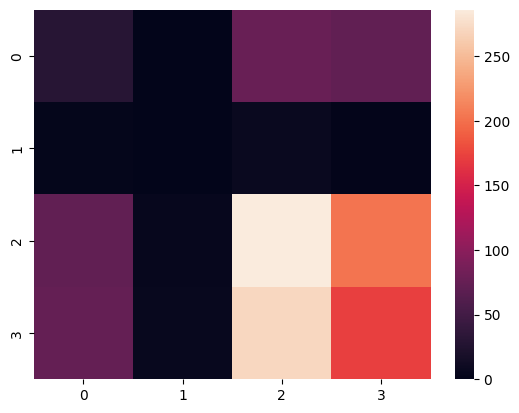

In [21]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
cm = confusion_matrix(y_pred, y_test)
sns.heatmap(cm)
plt.show()

In [22]:
%load_ext tensorboard


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [24]:

%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 16003), started 0:00:06 ago. (Use '!kill 16003' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
cm

array([[ 25,   0,  63,  49],
       [  0,   1,   3,   8],
       [ 79,   7, 307, 219],
       [ 75,   4, 267, 172]])

In [45]:
accuracy = np.trace(cm) / np.sum(cm)
print(f'Accuracy: {accuracy:.2%}')

Accuracy: 38.08%


1/1 [==============================] - 0s 31ms/step


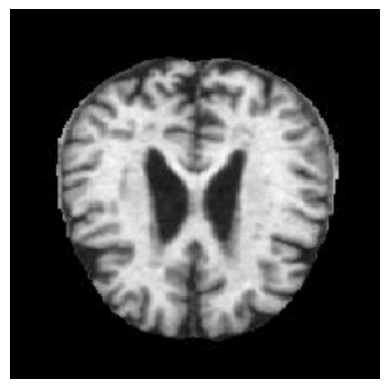

Real Class: MildDemented
Predicted Class: MildDemented
98.58% chances are there that the image is MildDemented

1/1 [==============================] - 0s 25ms/step


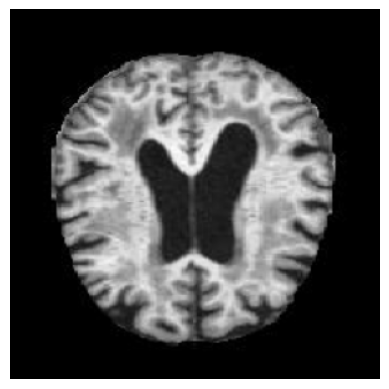

Real Class: MildDemented
Predicted Class: MildDemented
97.3% chances are there that the image is MildDemented

1/1 [==============================] - 0s 28ms/step


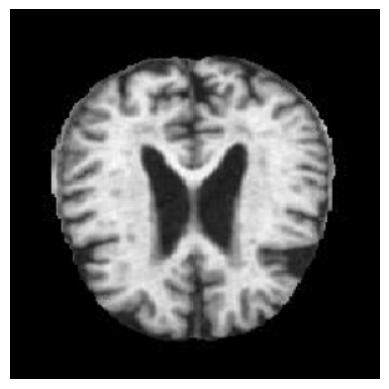

Real Class: MildDemented
Predicted Class: MildDemented
83.58% chances are there that the image is MildDemented

1/1 [==============================] - 0s 27ms/step


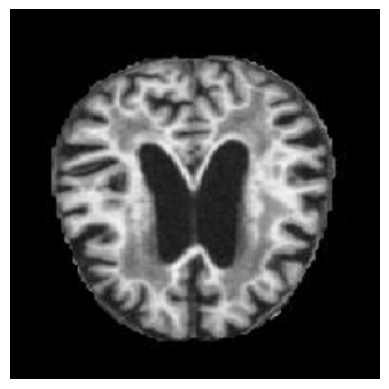

Real Class: MildDemented
Predicted Class: MildDemented
90.14% chances are there that the image is MildDemented

1/1 [==============================] - 0s 30ms/step


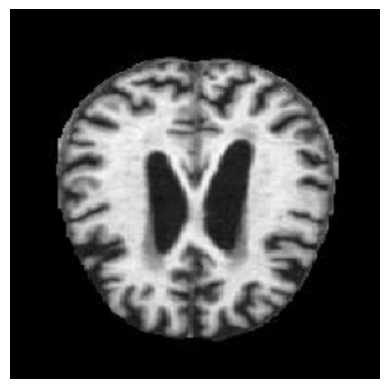

Real Class: MildDemented
Predicted Class: MildDemented
99.22% chances are there that the image is MildDemented

1/1 [==============================] - 0s 30ms/step


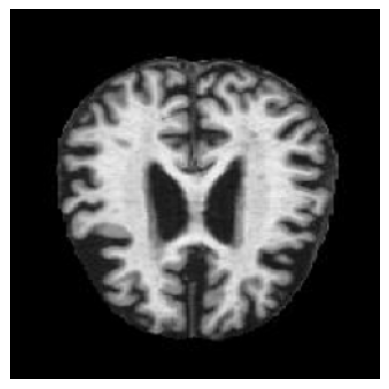

Real Class: MildDemented
Predicted Class: MildDemented
97.57% chances are there that the image is MildDemented

1/1 [==============================] - 0s 30ms/step


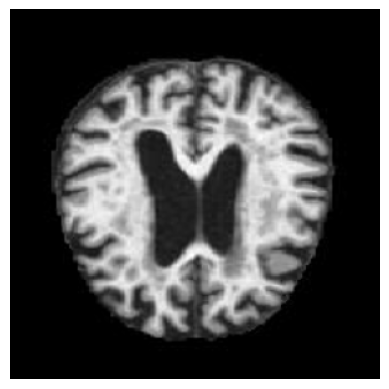

Real Class: MildDemented
Predicted Class: MildDemented
97.35% chances are there that the image is MildDemented

1/1 [==============================] - 0s 51ms/step


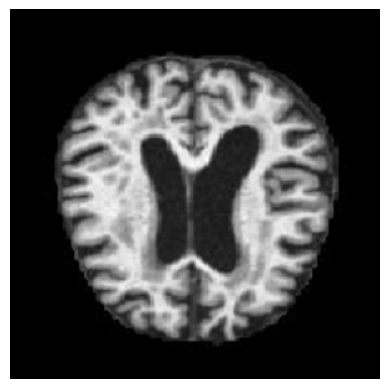

Real Class: MildDemented
Predicted Class: MildDemented
97.21% chances are there that the image is MildDemented

1/1 [==============================] - 0s 42ms/step


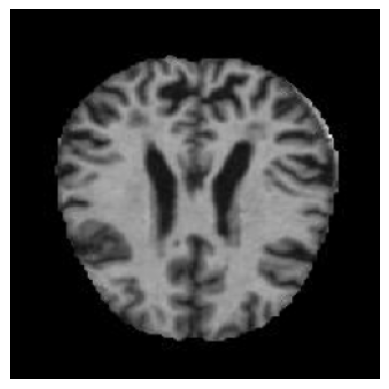

Real Class: MildDemented
Predicted Class: MildDemented
90.54% chances are there that the image is MildDemented

1/1 [==============================] - 0s 59ms/step


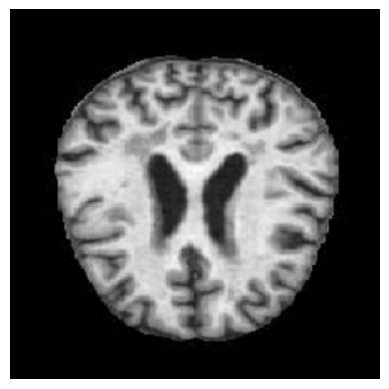

Real Class: MildDemented
Predicted Class: MildDemented
98.1% chances are there that the image is MildDemented

1/1 [==============================] - 0s 32ms/step


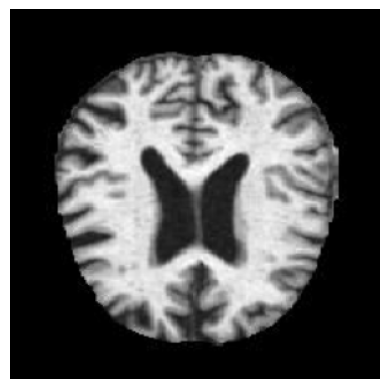

Real Class: MildDemented
Predicted Class: MildDemented
90.63% chances are there that the image is MildDemented

1/1 [==============================] - 0s 31ms/step


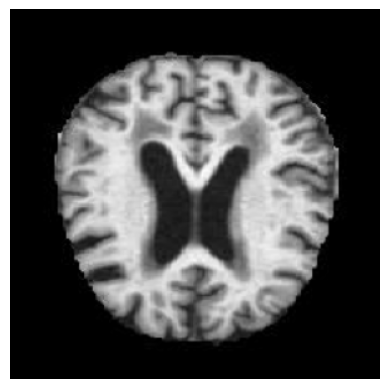

Real Class: MildDemented
Predicted Class: MildDemented
99.25% chances are there that the image is MildDemented

1/1 [==============================] - 0s 32ms/step


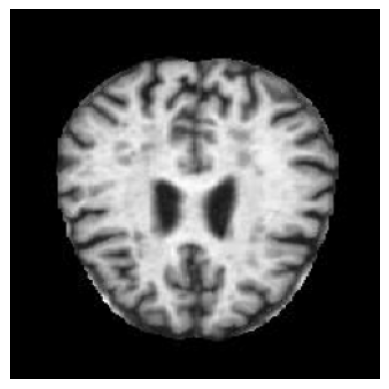

Real Class: MildDemented
Predicted Class: MildDemented
98.35% chances are there that the image is MildDemented

1/1 [==============================] - 0s 30ms/step


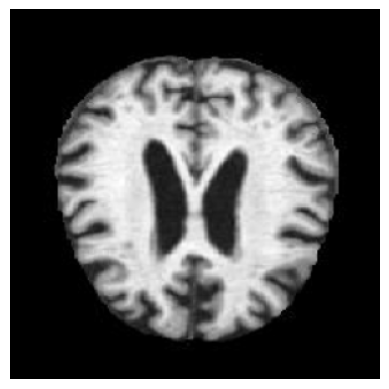

Real Class: MildDemented
Predicted Class: MildDemented
82.2% chances are there that the image is MildDemented

1/1 [==============================] - 0s 32ms/step


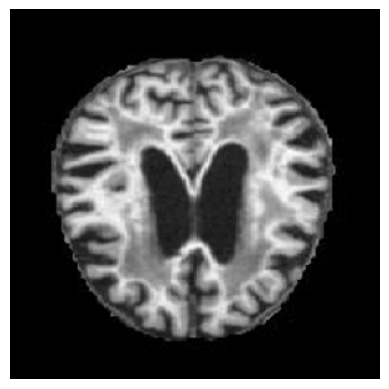

Real Class: MildDemented
Predicted Class: MildDemented
97.77% chances are there that the image is MildDemented

1/1 [==============================] - 0s 31ms/step


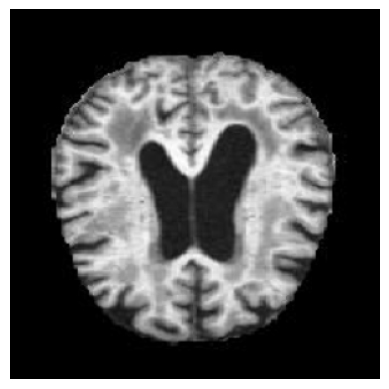

Real Class: MildDemented
Predicted Class: MildDemented
97.26% chances are there that the image is MildDemented

1/1 [==============================] - 0s 29ms/step


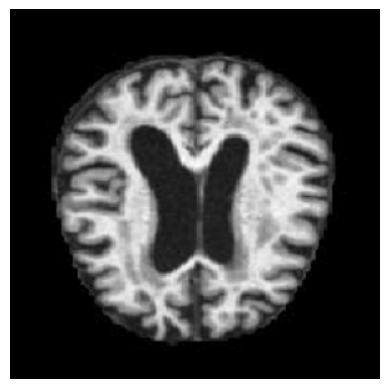

Real Class: MildDemented
Predicted Class: MildDemented
82.67% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


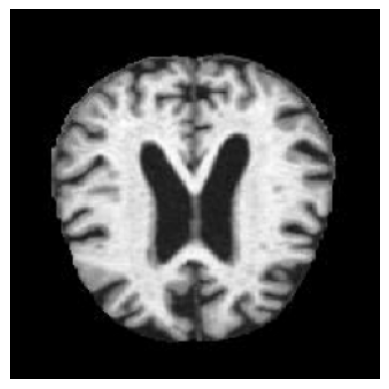

Real Class: MildDemented
Predicted Class: MildDemented
87.85% chances are there that the image is MildDemented

1/1 [==============================] - 0s 43ms/step


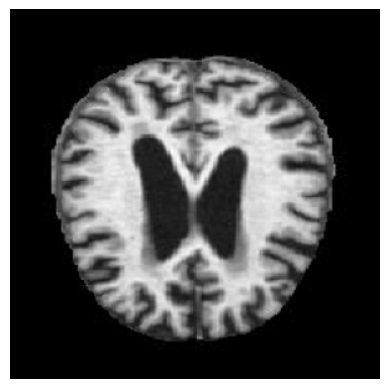

Real Class: MildDemented
Predicted Class: MildDemented
99.86% chances are there that the image is MildDemented

1/1 [==============================] - 0s 43ms/step


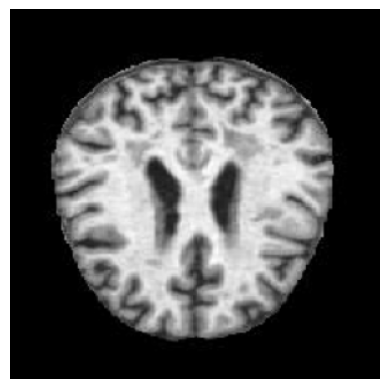

Real Class: MildDemented
Predicted Class: MildDemented
99.63% chances are there that the image is MildDemented

1/1 [==============================] - 0s 28ms/step


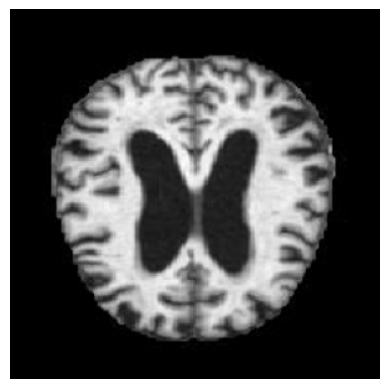

Real Class: MildDemented
Predicted Class: MildDemented
87.92% chances are there that the image is MildDemented

1/1 [==============================] - 0s 29ms/step


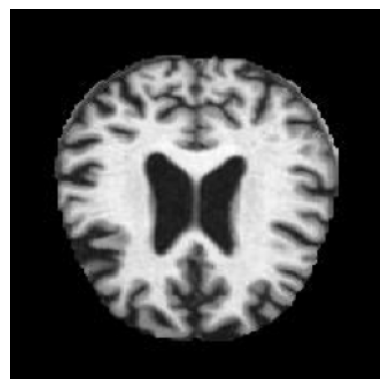

Real Class: MildDemented
Predicted Class: MildDemented
85.23% chances are there that the image is MildDemented

1/1 [==============================] - 0s 35ms/step


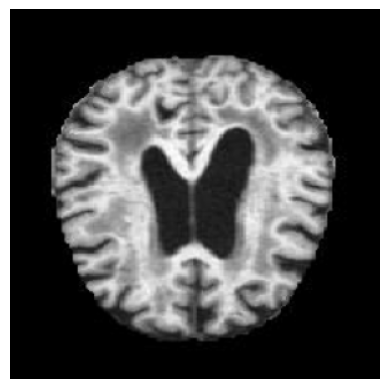

Real Class: MildDemented
Predicted Class: MildDemented
88.67% chances are there that the image is MildDemented

1/1 [==============================] - 0s 27ms/step


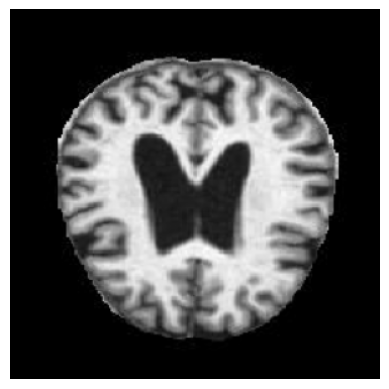

Real Class: MildDemented
Predicted Class: MildDemented
99.91% chances are there that the image is MildDemented

1/1 [==============================] - 0s 25ms/step


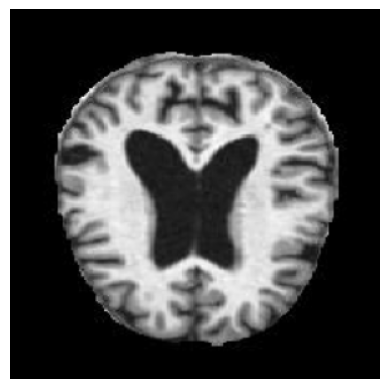

Real Class: MildDemented
Predicted Class: MildDemented
99.84% chances are there that the image is MildDemented

1/1 [==============================] - 0s 25ms/step


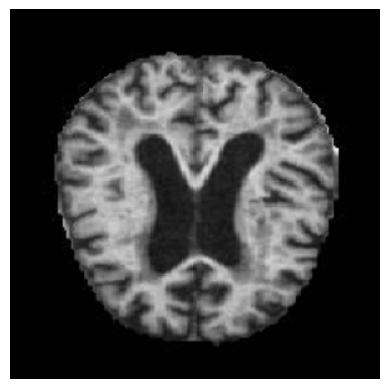

Real Class: MildDemented
Predicted Class: MildDemented
99.94% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


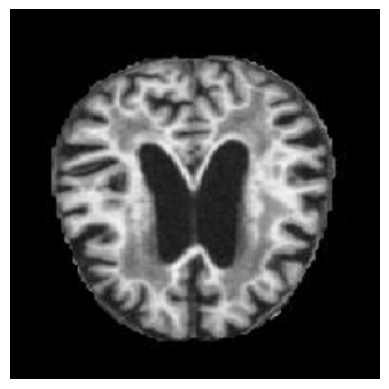

Real Class: MildDemented
Predicted Class: MildDemented
90.14% chances are there that the image is MildDemented

1/1 [==============================] - 0s 27ms/step


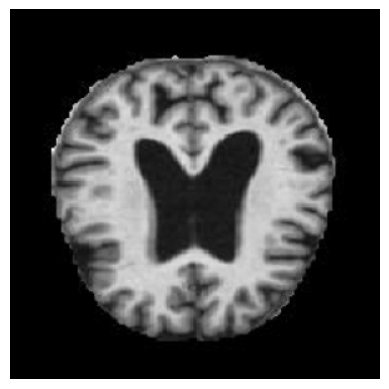

Real Class: MildDemented
Predicted Class: MildDemented
99.93% chances are there that the image is MildDemented

1/1 [==============================] - 0s 28ms/step


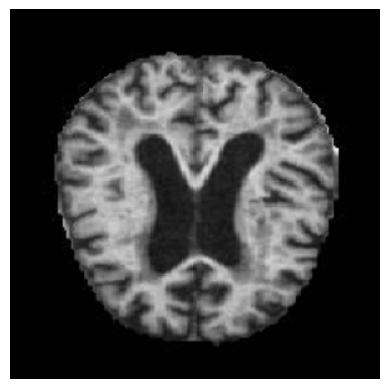

Real Class: MildDemented
Predicted Class: MildDemented
99.94% chances are there that the image is MildDemented

1/1 [==============================] - 0s 27ms/step


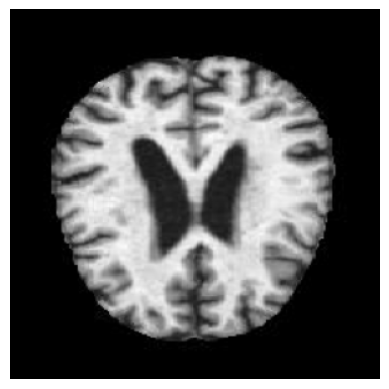

Real Class: MildDemented
Predicted Class: MildDemented
87.74% chances are there that the image is MildDemented

1/1 [==============================] - 0s 25ms/step


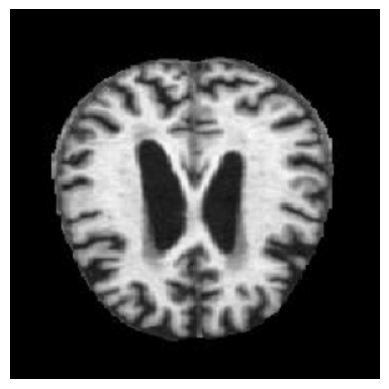

Real Class: MildDemented
Predicted Class: MildDemented
99.67% chances are there that the image is MildDemented

1/1 [==============================] - 0s 25ms/step


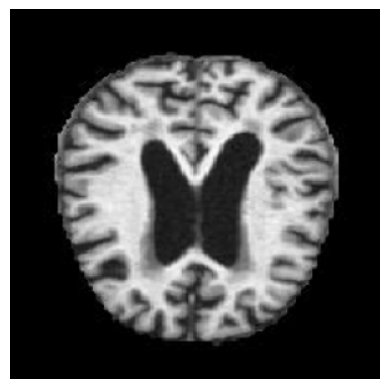

Real Class: MildDemented
Predicted Class: MildDemented
99.92% chances are there that the image is MildDemented

1/1 [==============================] - 0s 26ms/step


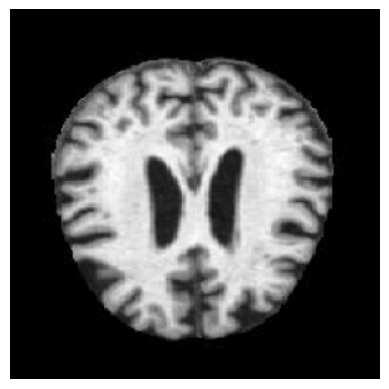

Real Class: MildDemented
Predicted Class: MildDemented
99.33% chances are there that the image is MildDemented

1/1 [==============================] - 0s 27ms/step


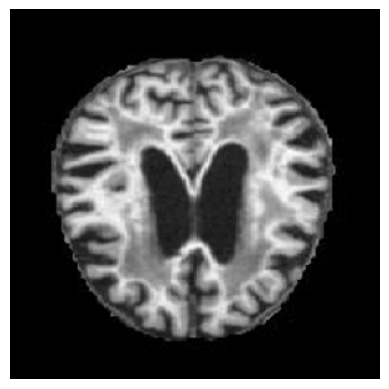

Real Class: MildDemented
Predicted Class: MildDemented
97.77% chances are there that the image is MildDemented

1/1 [==============================] - 0s 32ms/step


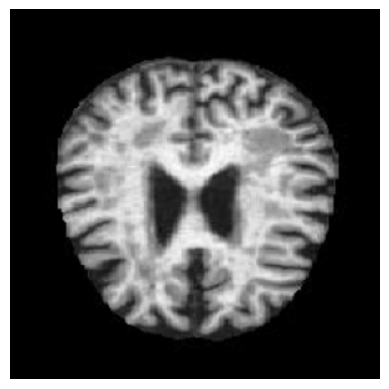

Real Class: MildDemented
Predicted Class: MildDemented
95.65% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


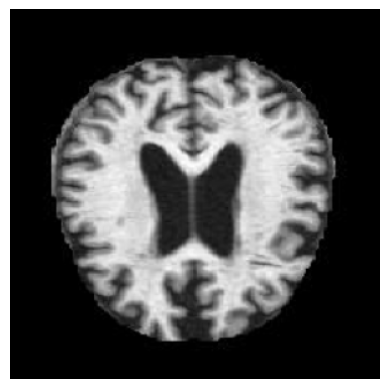

Real Class: MildDemented
Predicted Class: MildDemented
87.2% chances are there that the image is MildDemented

1/1 [==============================] - 0s 39ms/step


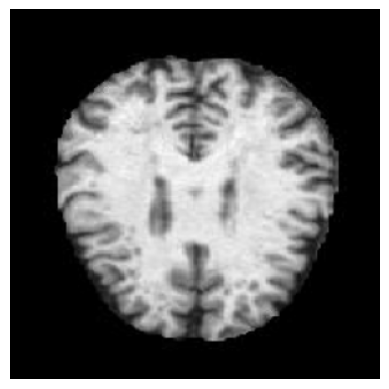

Real Class: MildDemented
Predicted Class: MildDemented
89.21% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


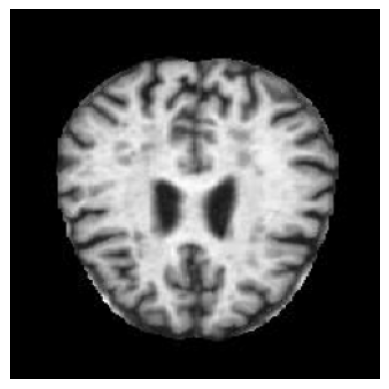

Real Class: MildDemented
Predicted Class: MildDemented
98.35% chances are there that the image is MildDemented

1/1 [==============================] - 0s 27ms/step


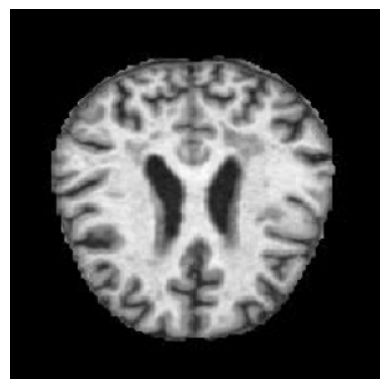

Real Class: MildDemented
Predicted Class: MildDemented
98.14% chances are there that the image is MildDemented

1/1 [==============================] - 0s 28ms/step


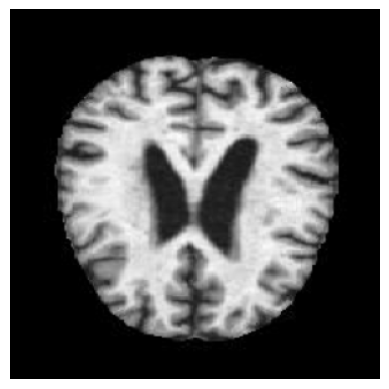

Real Class: MildDemented
Predicted Class: MildDemented
94.94% chances are there that the image is MildDemented

1/1 [==============================] - 0s 31ms/step


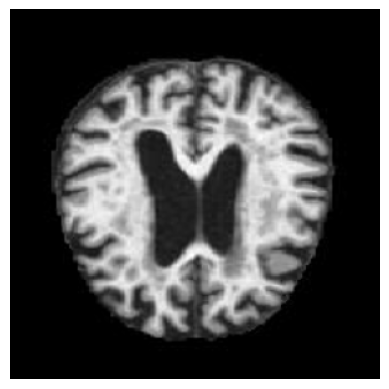

Real Class: MildDemented
Predicted Class: MildDemented
97.35% chances are there that the image is MildDemented

1/1 [==============================] - 0s 27ms/step


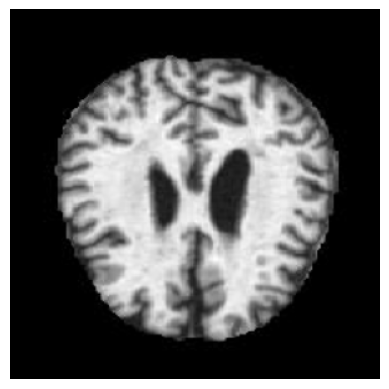

Real Class: MildDemented
Predicted Class: MildDemented
98.91% chances are there that the image is MildDemented

1/1 [==============================] - 0s 25ms/step


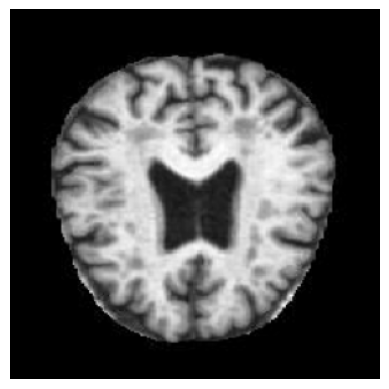

Real Class: MildDemented
Predicted Class: MildDemented
99.91% chances are there that the image is MildDemented

1/1 [==============================] - 0s 25ms/step


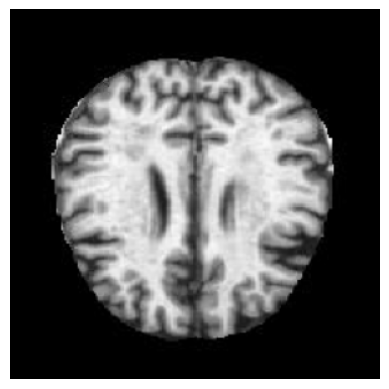

Real Class: MildDemented
Predicted Class: MildDemented
84.91% chances are there that the image is MildDemented

1/1 [==============================] - 0s 26ms/step


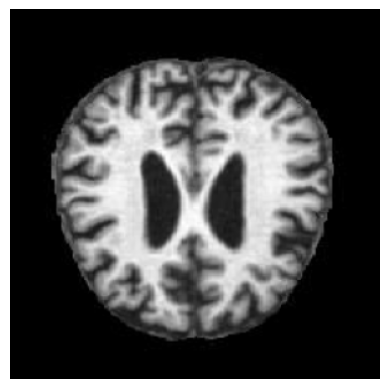

Real Class: MildDemented
Predicted Class: MildDemented
84.28% chances are there that the image is MildDemented

1/1 [==============================] - 0s 52ms/step


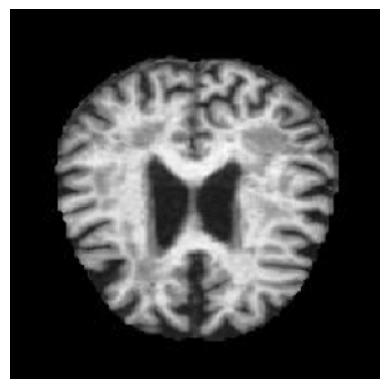

Real Class: MildDemented
Predicted Class: MildDemented
88.91% chances are there that the image is MildDemented

1/1 [==============================] - 0s 38ms/step


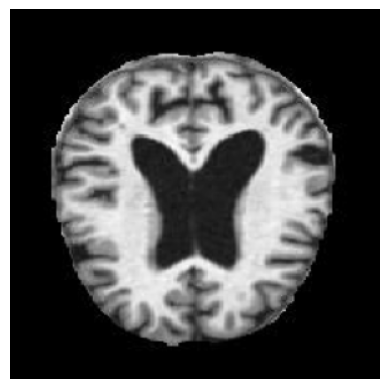

Real Class: MildDemented
Predicted Class: MildDemented
99.93% chances are there that the image is MildDemented

1/1 [==============================] - 0s 56ms/step


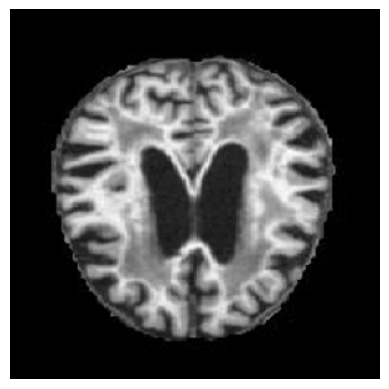

Real Class: MildDemented
Predicted Class: MildDemented
97.77% chances are there that the image is MildDemented

1/1 [==============================] - 0s 54ms/step


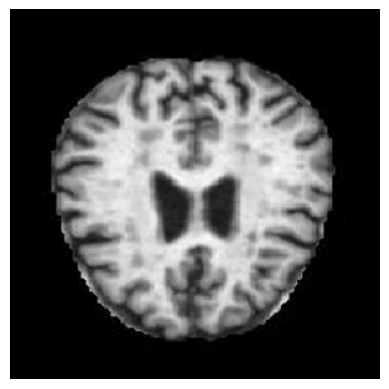

Real Class: MildDemented
Predicted Class: MildDemented
97.06% chances are there that the image is MildDemented

1/1 [==============================] - 0s 54ms/step


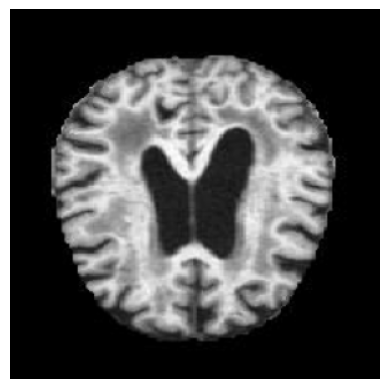

Real Class: MildDemented
Predicted Class: MildDemented
88.67% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


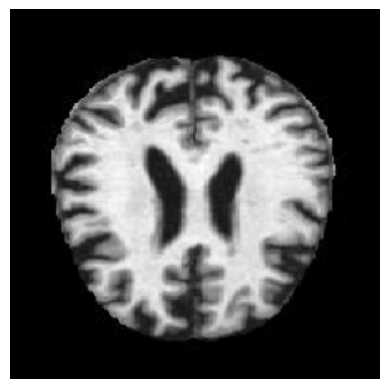

Real Class: MildDemented
Predicted Class: MildDemented
90.58% chances are there that the image is MildDemented

1/1 [==============================] - 0s 26ms/step


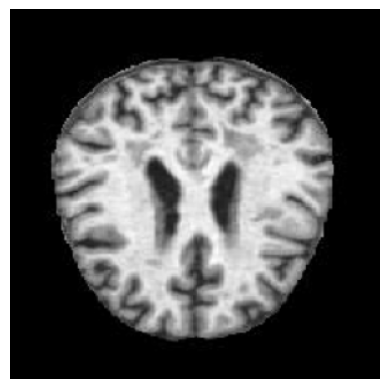

Real Class: MildDemented
Predicted Class: MildDemented
99.63% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


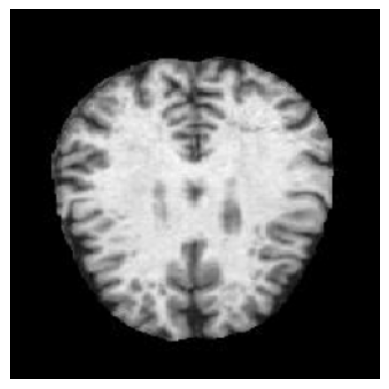

Real Class: MildDemented
Predicted Class: MildDemented
87.97% chances are there that the image is MildDemented

1/1 [==============================] - 0s 32ms/step


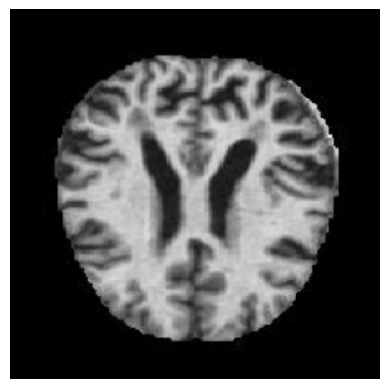

Real Class: MildDemented
Predicted Class: MildDemented
99.73% chances are there that the image is MildDemented

1/1 [==============================] - 0s 26ms/step


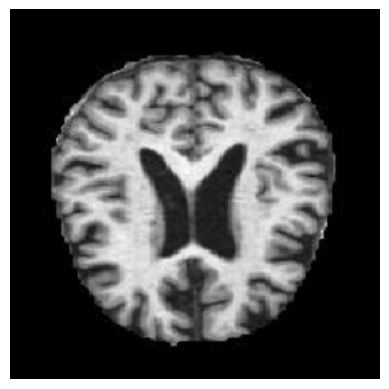

Real Class: MildDemented
Predicted Class: MildDemented
92.99% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


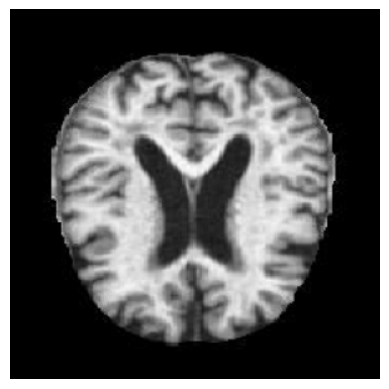

Real Class: MildDemented
Predicted Class: MildDemented
99.66% chances are there that the image is MildDemented

1/1 [==============================] - 0s 31ms/step


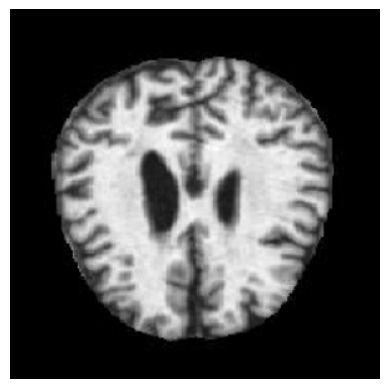

Real Class: MildDemented
Predicted Class: MildDemented
92.47% chances are there that the image is MildDemented

1/1 [==============================] - 0s 53ms/step


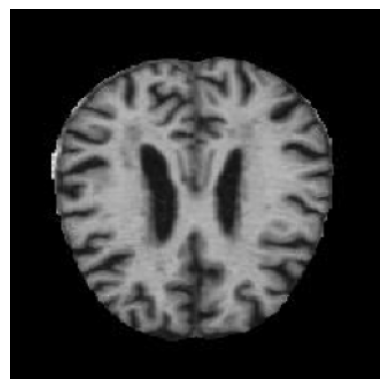

Real Class: MildDemented
Predicted Class: MildDemented
98.65% chances are there that the image is MildDemented

1/1 [==============================] - 0s 78ms/step


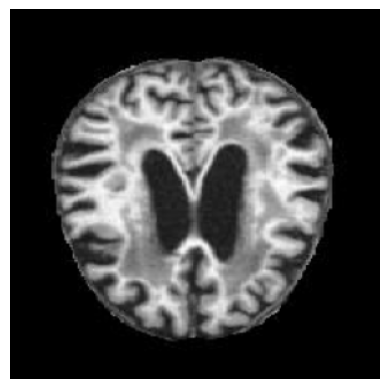

Real Class: MildDemented
Predicted Class: MildDemented
99.74% chances are there that the image is MildDemented

1/1 [==============================] - 0s 67ms/step


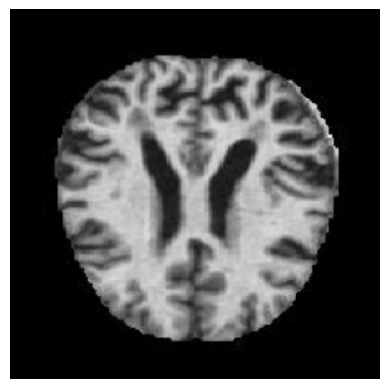

Real Class: MildDemented
Predicted Class: MildDemented
99.73% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


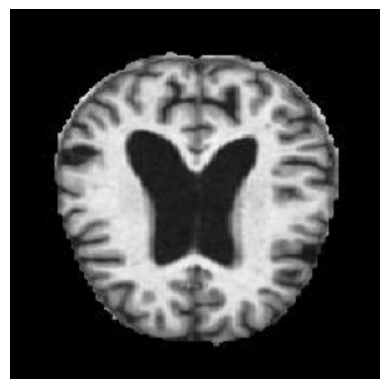

Real Class: MildDemented
Predicted Class: MildDemented
99.72% chances are there that the image is MildDemented

1/1 [==============================] - 0s 46ms/step


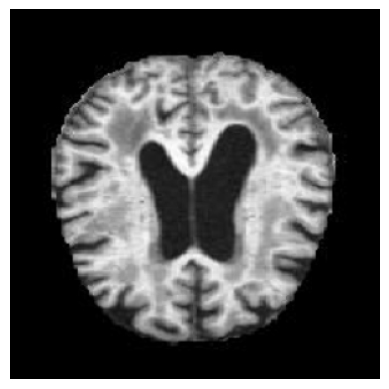

Real Class: MildDemented
Predicted Class: MildDemented
97.26% chances are there that the image is MildDemented

1/1 [==============================] - 0s 76ms/step


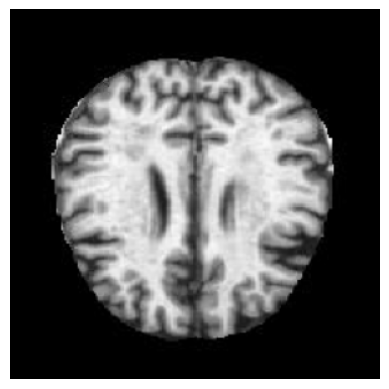

Real Class: MildDemented
Predicted Class: MildDemented
84.91% chances are there that the image is MildDemented

1/1 [==============================] - 0s 70ms/step


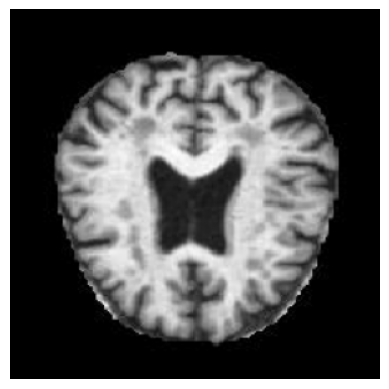

Real Class: MildDemented
Predicted Class: MildDemented
85.33% chances are there that the image is MildDemented

1/1 [==============================] - 0s 38ms/step


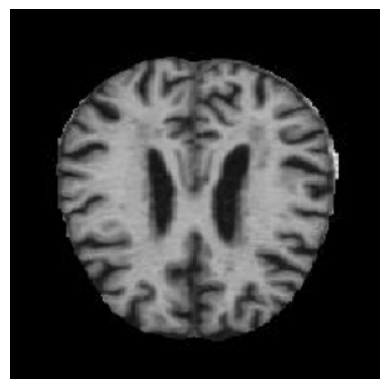

Real Class: MildDemented
Predicted Class: MildDemented
96.16% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


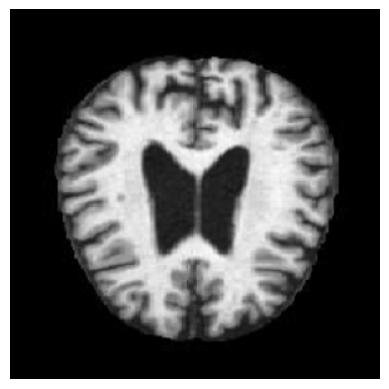

Real Class: MildDemented
Predicted Class: MildDemented
92.15% chances are there that the image is MildDemented

1/1 [==============================] - 0s 38ms/step


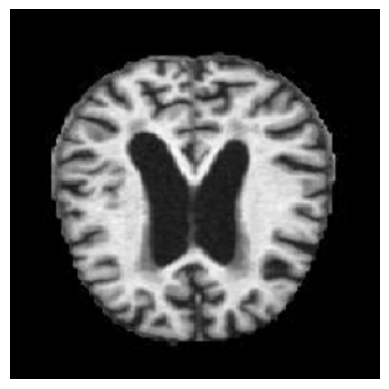

Real Class: MildDemented
Predicted Class: MildDemented
99.96% chances are there that the image is MildDemented

1/1 [==============================] - 0s 36ms/step


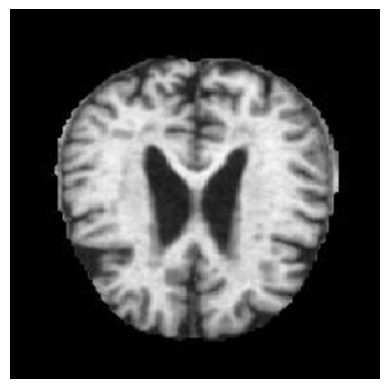

Real Class: MildDemented
Predicted Class: MildDemented
96.09% chances are there that the image is MildDemented

1/1 [==============================] - 0s 39ms/step


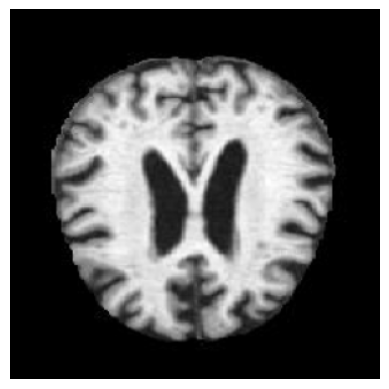

Real Class: MildDemented
Predicted Class: MildDemented
99.02% chances are there that the image is MildDemented

1/1 [==============================] - 0s 36ms/step


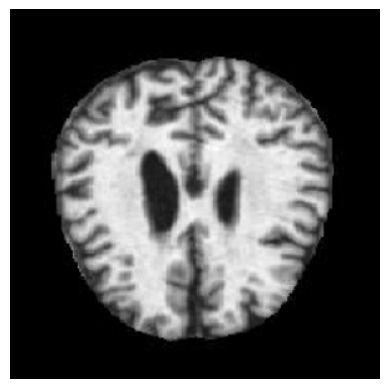

Real Class: MildDemented
Predicted Class: MildDemented
92.47% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


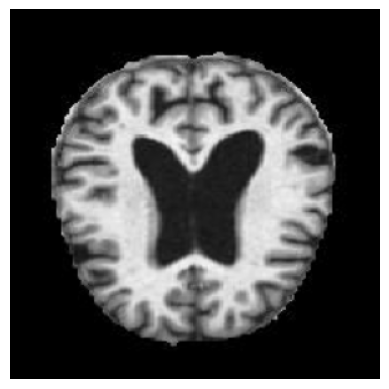

Real Class: MildDemented
Predicted Class: MildDemented
99.85% chances are there that the image is MildDemented

1/1 [==============================] - 0s 39ms/step


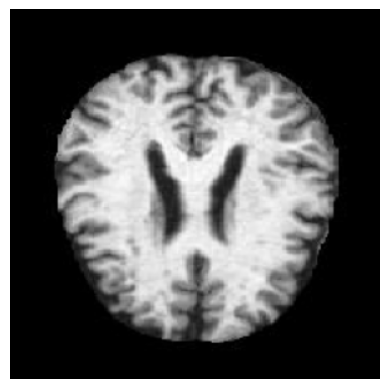

Real Class: MildDemented
Predicted Class: MildDemented
99.69% chances are there that the image is MildDemented

1/1 [==============================] - 0s 93ms/step


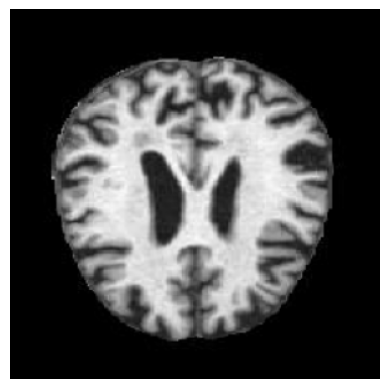

Real Class: MildDemented
Predicted Class: MildDemented
96.81% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


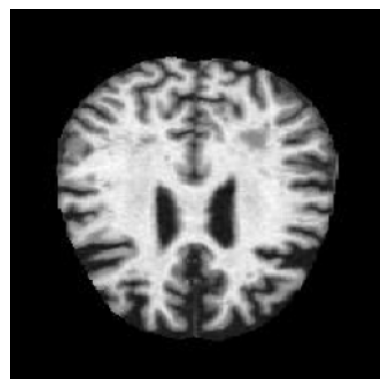

Real Class: MildDemented
Predicted Class: MildDemented
86.37% chances are there that the image is MildDemented

1/1 [==============================] - 0s 50ms/step


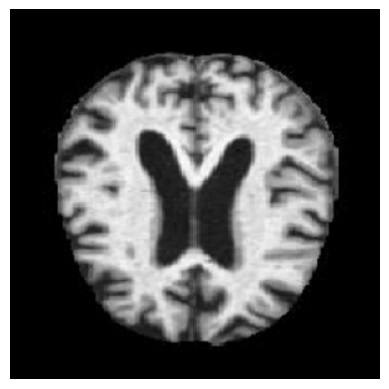

Real Class: MildDemented
Predicted Class: MildDemented
99.14% chances are there that the image is MildDemented

1/1 [==============================] - 0s 84ms/step


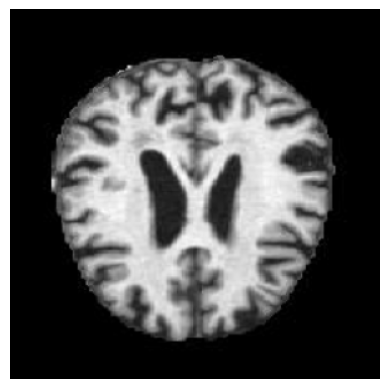

Real Class: MildDemented
Predicted Class: MildDemented
85.69% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


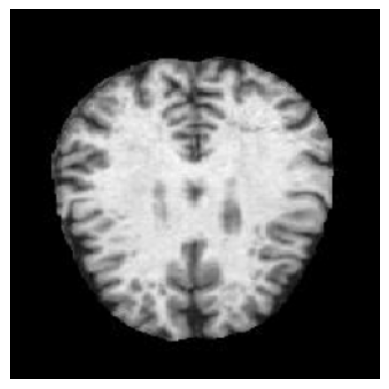

Real Class: MildDemented
Predicted Class: MildDemented
87.97% chances are there that the image is MildDemented

1/1 [==============================] - 0s 38ms/step


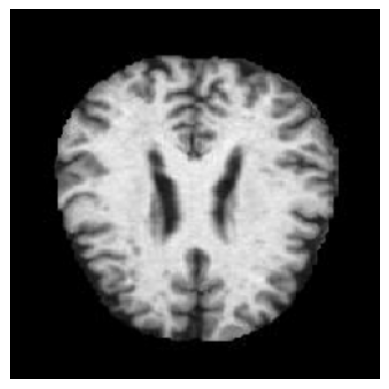

Real Class: MildDemented
Predicted Class: MildDemented
99.81% chances are there that the image is MildDemented

1/1 [==============================] - 0s 38ms/step


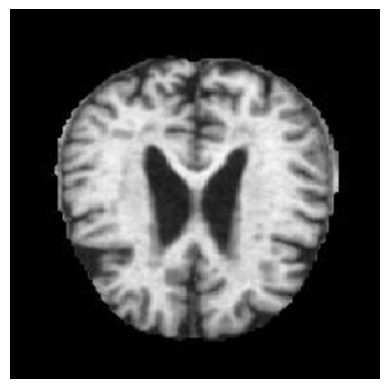

Real Class: MildDemented
Predicted Class: MildDemented
96.09% chances are there that the image is MildDemented

1/1 [==============================] - 0s 42ms/step


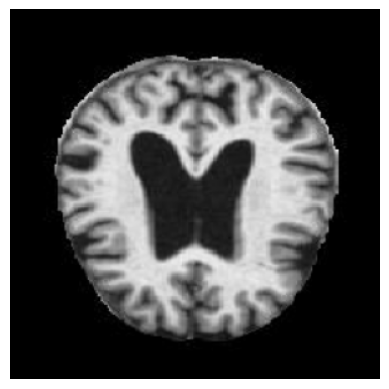

Real Class: MildDemented
Predicted Class: MildDemented
99.71% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


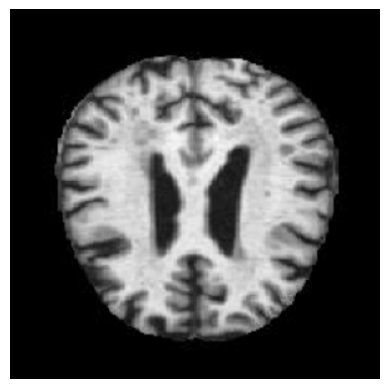

Real Class: MildDemented
Predicted Class: MildDemented
90.22% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


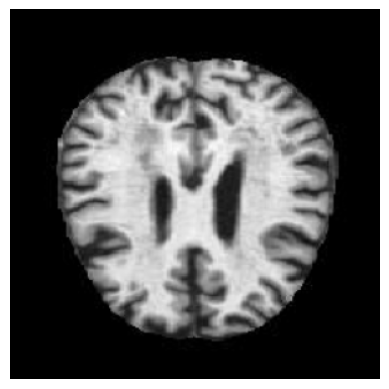

Real Class: MildDemented
Predicted Class: MildDemented
93.05% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


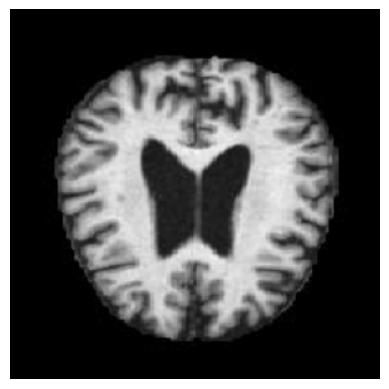

Real Class: MildDemented
Predicted Class: MildDemented
80.53% chances are there that the image is MildDemented

1/1 [==============================] - 0s 48ms/step


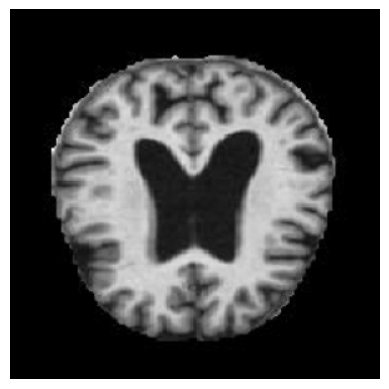

Real Class: MildDemented
Predicted Class: MildDemented
99.93% chances are there that the image is MildDemented

1/1 [==============================] - 0s 82ms/step


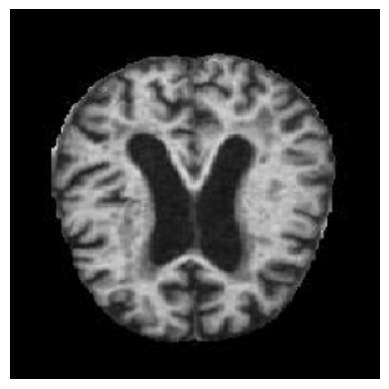

Real Class: MildDemented
Predicted Class: MildDemented
99.93% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


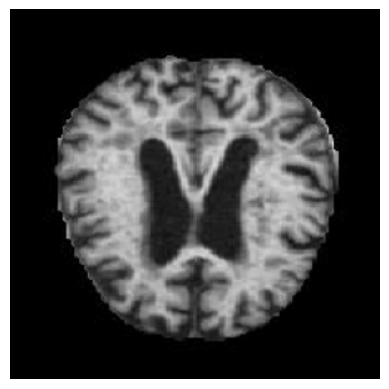

Real Class: MildDemented
Predicted Class: MildDemented
99.9% chances are there that the image is MildDemented

1/1 [==============================] - 0s 45ms/step


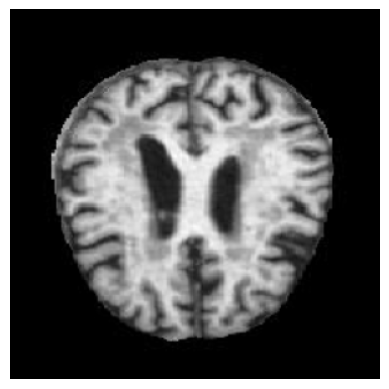

Real Class: MildDemented
Predicted Class: MildDemented
94.19% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


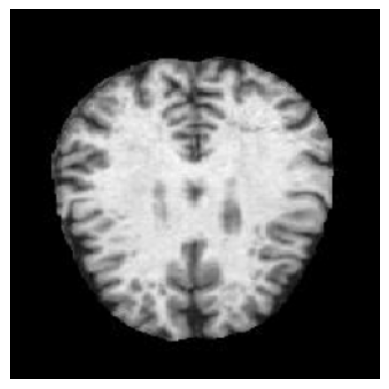

Real Class: MildDemented
Predicted Class: MildDemented
87.97% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


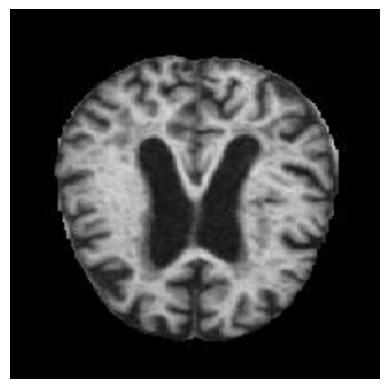

Real Class: MildDemented
Predicted Class: MildDemented
99.93% chances are there that the image is MildDemented

1/1 [==============================] - 0s 47ms/step


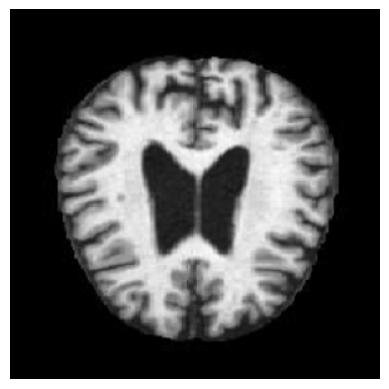

Real Class: MildDemented
Predicted Class: MildDemented
92.15% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


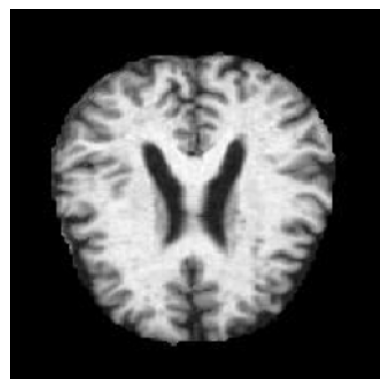

Real Class: MildDemented
Predicted Class: MildDemented
99.4% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


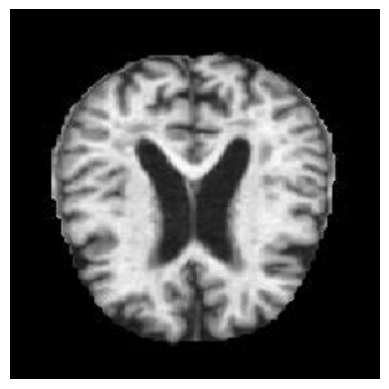

Real Class: MildDemented
Predicted Class: MildDemented
99.9% chances are there that the image is MildDemented

1/1 [==============================] - 0s 62ms/step


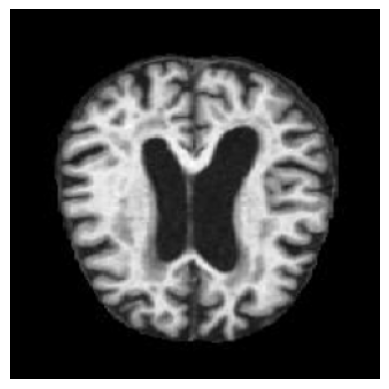

Real Class: MildDemented
Predicted Class: MildDemented
97.03% chances are there that the image is MildDemented

1/1 [==============================] - 0s 53ms/step


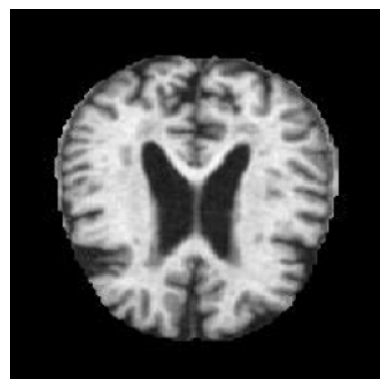

Real Class: MildDemented
Predicted Class: MildDemented
97.65% chances are there that the image is MildDemented

1/1 [==============================] - 0s 52ms/step


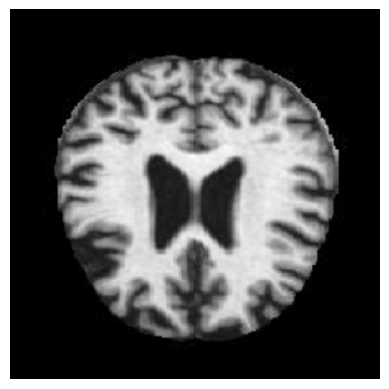

Real Class: MildDemented
Predicted Class: MildDemented
95.44% chances are there that the image is MildDemented

1/1 [==============================] - 0s 59ms/step


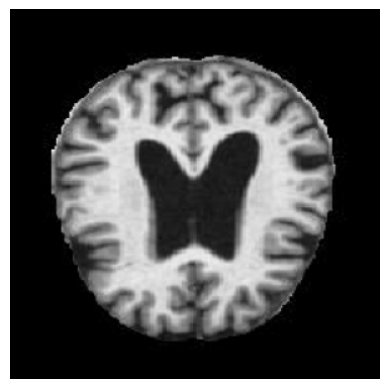

Real Class: MildDemented
Predicted Class: MildDemented
99.95% chances are there that the image is MildDemented

1/1 [==============================] - 0s 64ms/step


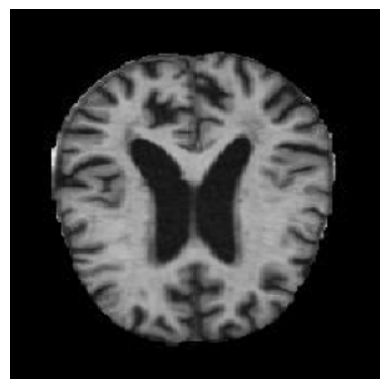

Real Class: MildDemented
Predicted Class: MildDemented
85.72% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


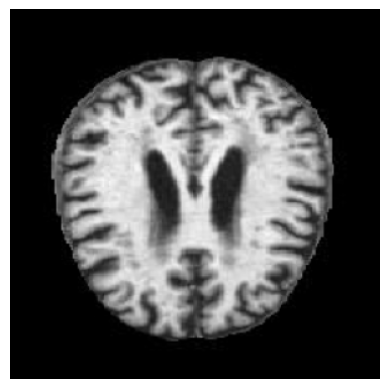

Real Class: MildDemented
Predicted Class: MildDemented
88.63% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


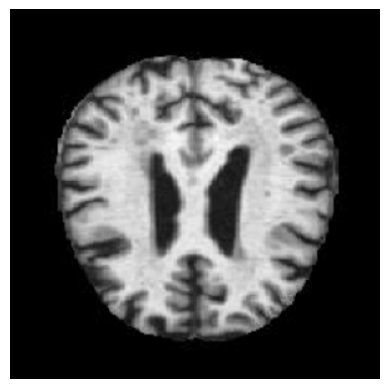

Real Class: MildDemented
Predicted Class: MildDemented
90.22% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


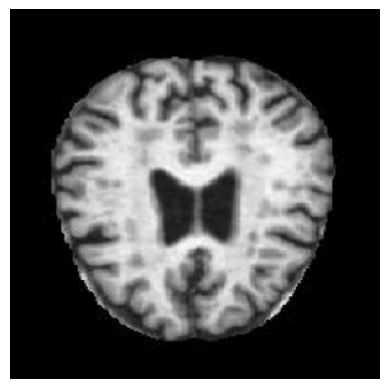

Real Class: MildDemented
Predicted Class: MildDemented
99.15% chances are there that the image is MildDemented

1/1 [==============================] - 0s 39ms/step


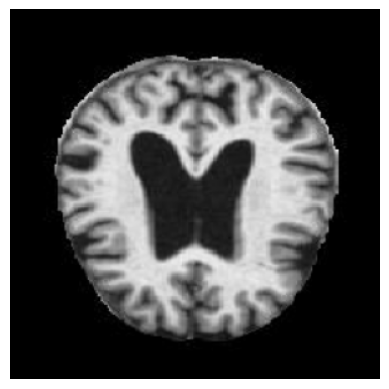

Real Class: MildDemented
Predicted Class: MildDemented
99.71% chances are there that the image is MildDemented

1/1 [==============================] - 0s 36ms/step


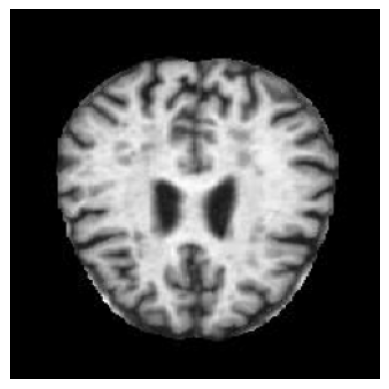

Real Class: MildDemented
Predicted Class: MildDemented
98.35% chances are there that the image is MildDemented

1/1 [==============================] - 0s 71ms/step


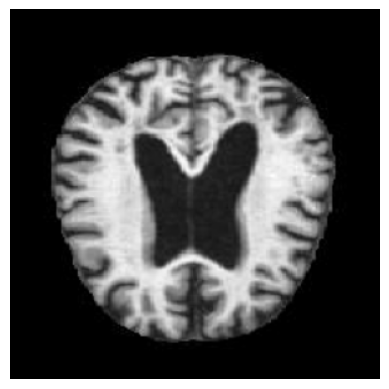

Real Class: MildDemented
Predicted Class: MildDemented
98.23% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


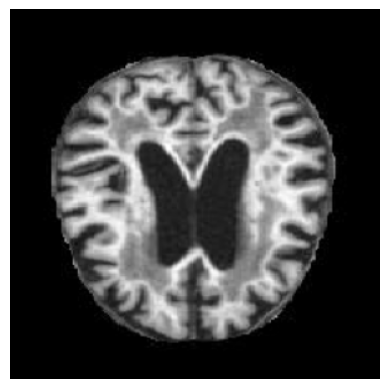

Real Class: MildDemented
Predicted Class: MildDemented
99.12% chances are there that the image is MildDemented

1/1 [==============================] - 0s 39ms/step


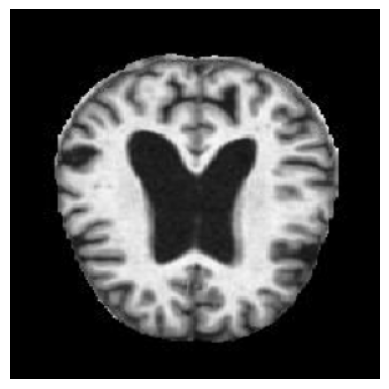

Real Class: MildDemented
Predicted Class: MildDemented
99.44% chances are there that the image is MildDemented

1/1 [==============================] - 0s 78ms/step


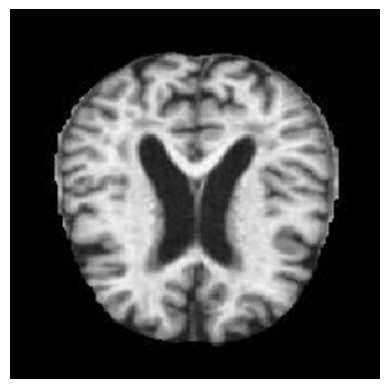

Real Class: MildDemented
Predicted Class: MildDemented
99.58% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


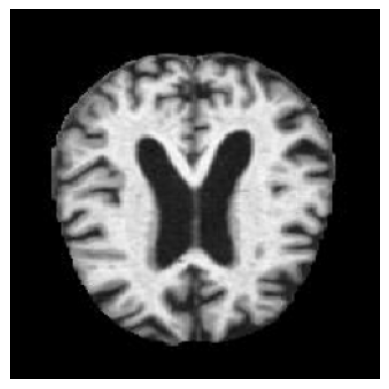

Real Class: MildDemented
Predicted Class: MildDemented
99.82% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


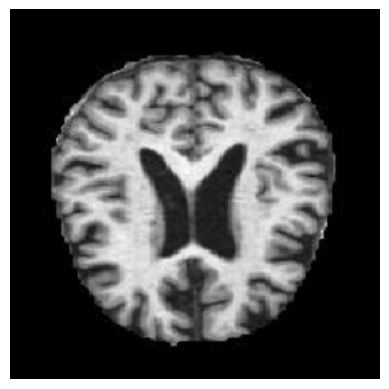

Real Class: MildDemented
Predicted Class: MildDemented
92.99% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


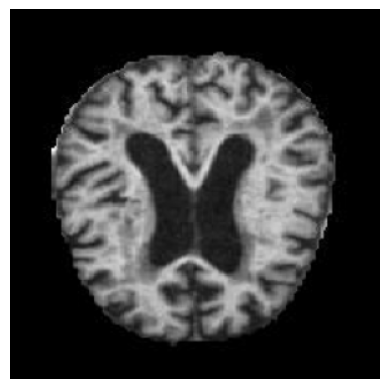

Real Class: MildDemented
Predicted Class: MildDemented
99.95% chances are there that the image is MildDemented

1/1 [==============================] - 0s 37ms/step


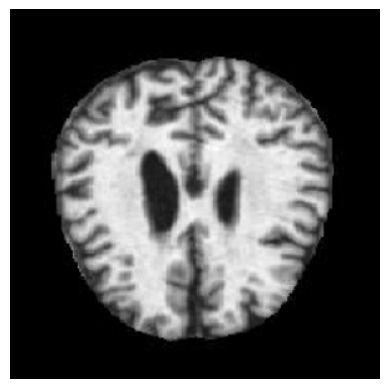

Real Class: MildDemented
Predicted Class: MildDemented
92.47% chances are there that the image is MildDemented

1/1 [==============================] - 0s 38ms/step


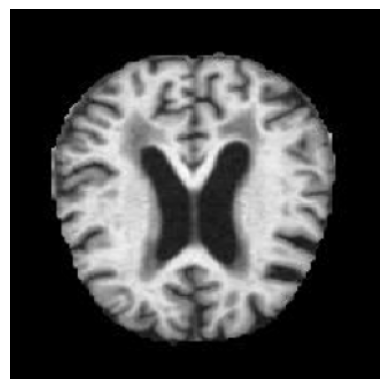

Real Class: MildDemented
Predicted Class: MildDemented
99.88% chances are there that the image is MildDemented

1/1 [==============================] - 0s 50ms/step


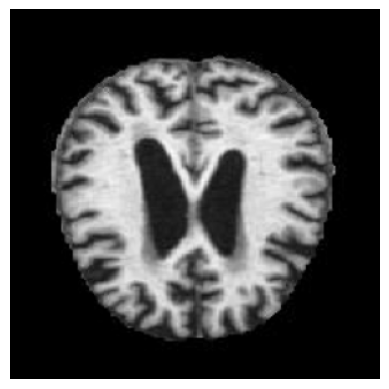

Real Class: MildDemented
Predicted Class: MildDemented
99.84% chances are there that the image is MildDemented

1/1 [==============================] - 0s 46ms/step


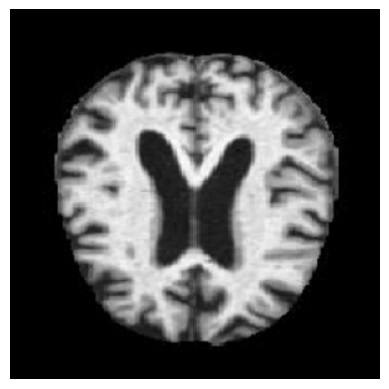

Real Class: MildDemented
Predicted Class: MildDemented
99.14% chances are there that the image is MildDemented

1/1 [==============================] - 0s 73ms/step


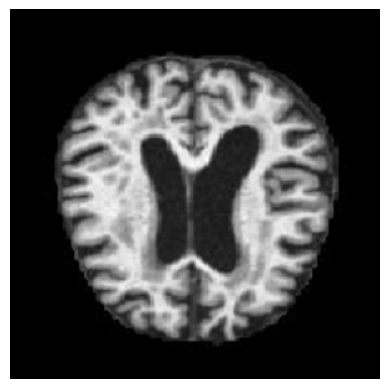

Real Class: MildDemented
Predicted Class: MildDemented
97.21% chances are there that the image is MildDemented

1/1 [==============================] - 0s 64ms/step


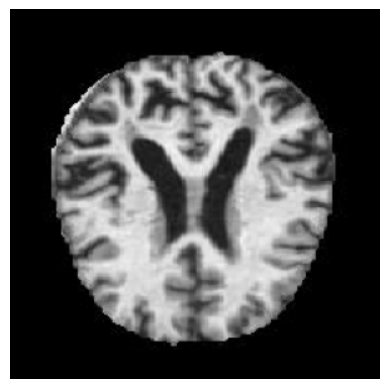

Real Class: MildDemented
Predicted Class: MildDemented
96.5% chances are there that the image is MildDemented

1/1 [==============================] - 0s 42ms/step


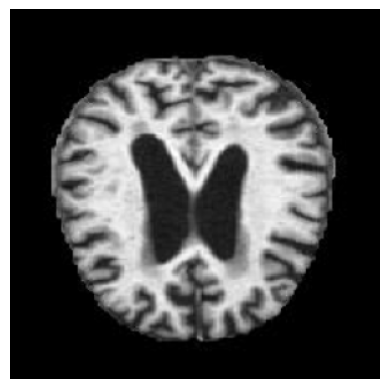

Real Class: MildDemented
Predicted Class: MildDemented
99.92% chances are there that the image is MildDemented

1/1 [==============================] - 0s 44ms/step


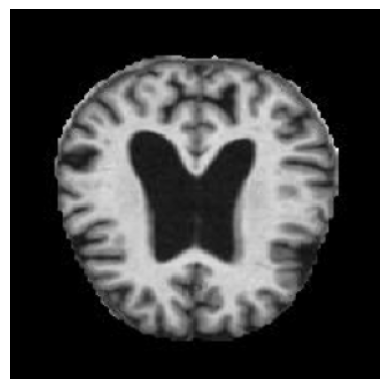

Real Class: MildDemented
Predicted Class: MildDemented
95.89% chances are there that the image is MildDemented

1/1 [==============================] - 0s 48ms/step


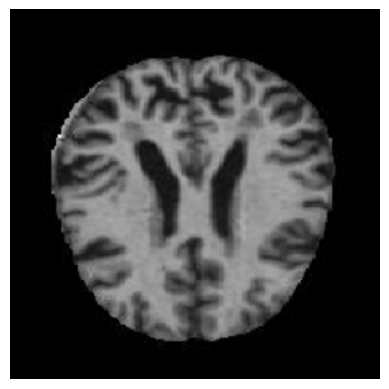

Real Class: MildDemented
Predicted Class: MildDemented
99.13% chances are there that the image is MildDemented

1/1 [==============================] - 0s 48ms/step


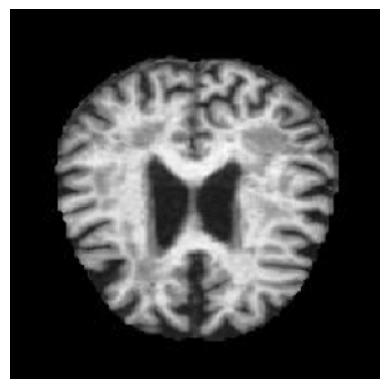

Real Class: MildDemented
Predicted Class: MildDemented
88.91% chances are there that the image is MildDemented

1/1 [==============================] - 0s 43ms/step


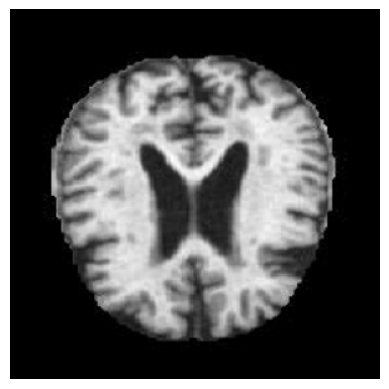

Real Class: MildDemented
Predicted Class: MildDemented
97.87% chances are there that the image is MildDemented

1/1 [==============================] - 0s 76ms/step


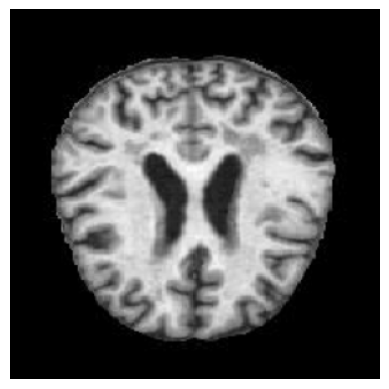

Real Class: MildDemented
Predicted Class: MildDemented
90.37% chances are there that the image is MildDemented

1/1 [==============================] - 0s 58ms/step


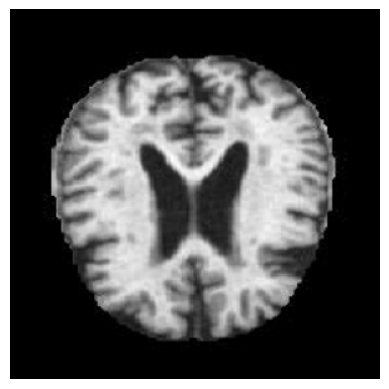

Real Class: MildDemented
Predicted Class: MildDemented
97.87% chances are there that the image is MildDemented

1/1 [==============================] - 0s 68ms/step


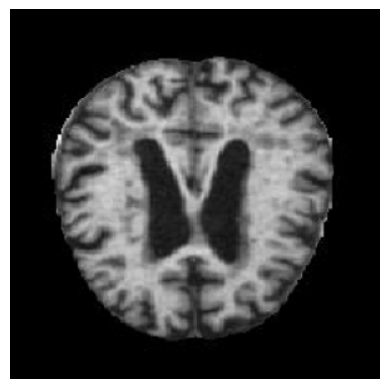

Real Class: MildDemented
Predicted Class: MildDemented
99.94% chances are there that the image is MildDemented

1/1 [==============================] - 0s 45ms/step


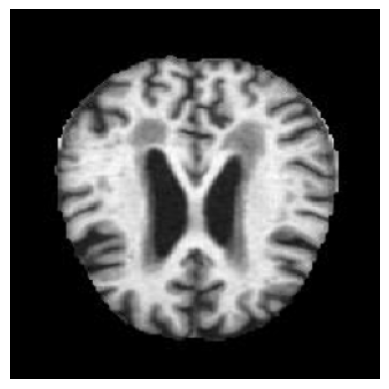

Real Class: MildDemented
Predicted Class: MildDemented
99.86% chances are there that the image is MildDemented

1/1 [==============================] - 0s 66ms/step


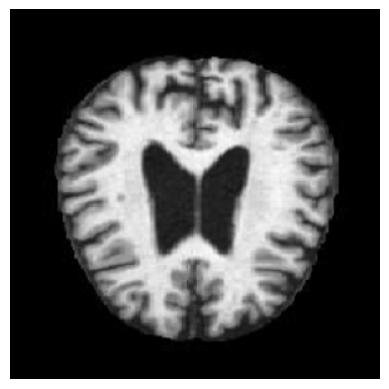

Real Class: MildDemented
Predicted Class: MildDemented
92.15% chances are there that the image is MildDemented

1/1 [==============================] - 0s 56ms/step


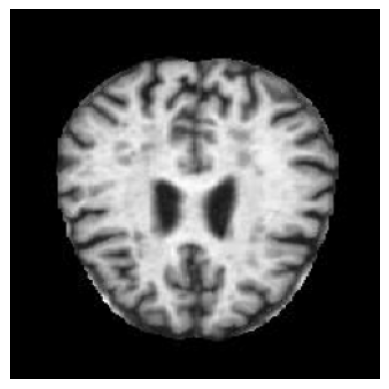

Real Class: MildDemented
Predicted Class: MildDemented
98.35% chances are there that the image is MildDemented

1/1 [==============================] - 0s 43ms/step


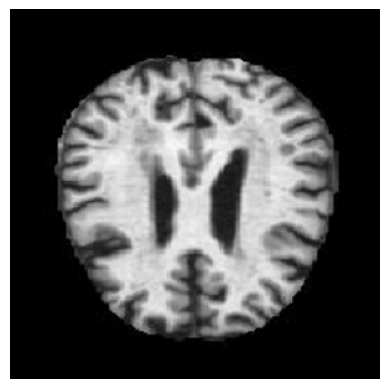

Real Class: MildDemented
Predicted Class: MildDemented
96.71% chances are there that the image is MildDemented

1/1 [==============================] - 0s 39ms/step


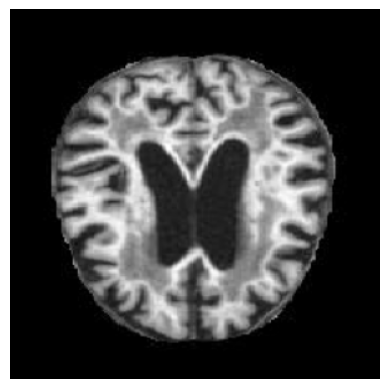

Real Class: MildDemented
Predicted Class: MildDemented
99.12% chances are there that the image is MildDemented

1/1 [==============================] - 0s 43ms/step


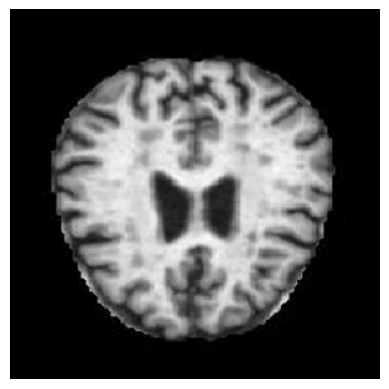

Real Class: MildDemented
Predicted Class: MildDemented
97.06% chances are there that the image is MildDemented

1/1 [==============================] - 0s 67ms/step


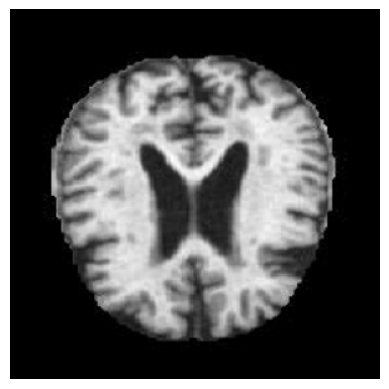

Real Class: MildDemented
Predicted Class: MildDemented
97.87% chances are there that the image is MildDemented

1/1 [==============================] - 0s 43ms/step


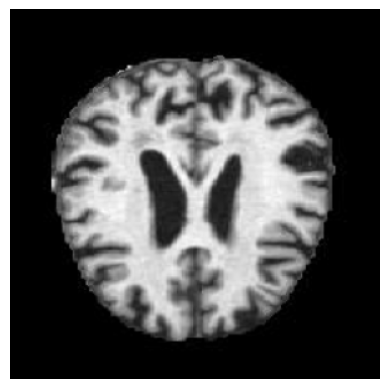

Real Class: MildDemented
Predicted Class: MildDemented
85.69% chances are there that the image is MildDemented

1/1 [==============================] - 0s 42ms/step


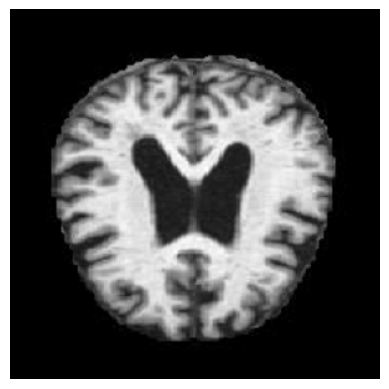

Real Class: MildDemented
Predicted Class: MildDemented
86.9% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


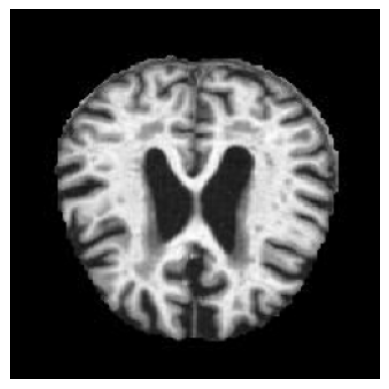

Real Class: MildDemented
Predicted Class: MildDemented
80.1% chances are there that the image is MildDemented

1/1 [==============================] - 0s 40ms/step


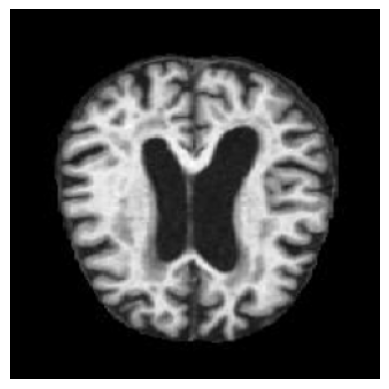

Real Class: MildDemented
Predicted Class: MildDemented
97.03% chances are there that the image is MildDemented

1/1 [==============================] - 0s 41ms/step


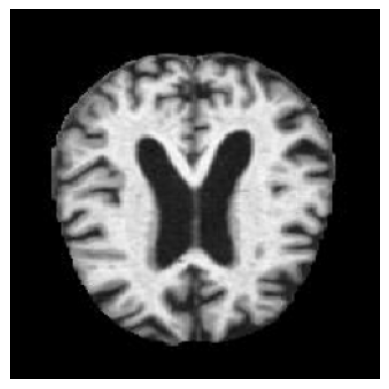

Real Class: MildDemented
Predicted Class: MildDemented
99.82% chances are there that the image is MildDemented

1/1 [==============================] - 0s 43ms/step


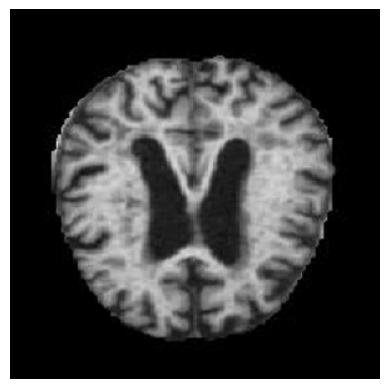

Real Class: MildDemented
Predicted Class: MildDemented
99.95% chances are there that the image is MildDemented

1/1 [==============================] - 0s 60ms/step


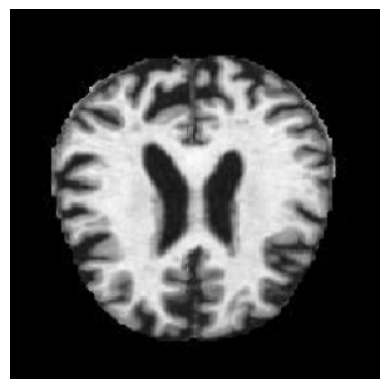

Real Class: MildDemented
Predicted Class: MildDemented
94.02% chances are there that the image is MildDemented

1/1 [==============================] - 0s 65ms/step


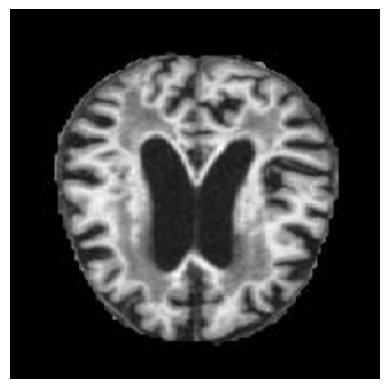

Real Class: MildDemented
Predicted Class: MildDemented
99.88% chances are there that the image is MildDemented

1/1 [==============================] - 0s 64ms/step


In [33]:
from tensorflow.image import resize

# Get class indices from x_test_balanced
class_indices = x_test.class_indices

# Create a dictionary mapping class indices to class labels
class_labels = {v: k for k, v in class_indices.items()}

# Get a batch of images and labels from x_test_balanced
batch_size = 1  # Adjust this according to your needs
for _ in range(int(np.ceil(x_test.n / batch_size))):
    # Get a batch of images and labels
    batch_images, batch_labels = next(x_test)

    # Take the first image and its corresponding label from the batch
    test_image_array = batch_images[0]
    real_class = batch_labels[0]

    # Resize the input image to match the model's expected input size
    test_image_array = resize(test_image_array, (299, 299))

    # Make a prediction on the test image
    predicted_probabilities = model.predict(np.expand_dims(test_image_array, axis=0))
    predicted_class = np.argmax(predicted_probabilities)
    predicted_label = class_labels[predicted_class]
    probability = round(np.max(predicted_probabilities) * 100, 2)

    # Display the test image only if conditions are met
    if predicted_class == np.argmax(real_class) and probability > 80:
        plt.imshow(test_image_array)
        plt.axis('off')
        plt.show()

        # Print the real class and predicted results
        print(f"Real Class: {class_labels[np.argmax(real_class)]}")
        print(f"Predicted Class: {predicted_label}")
        print(f"{probability}% chances are there that the image is {predicted_label}\n")


1/1 [==============================] - 0s 27ms/step


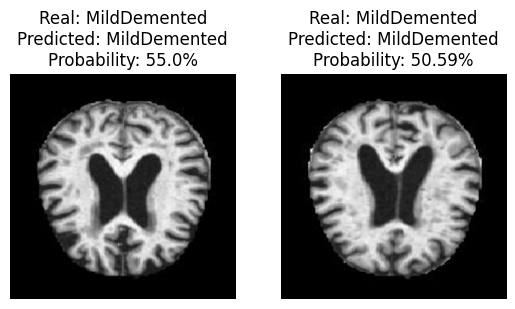

In [31]:
from tensorflow.image import resize

# Get class indices from x_test_balanced
class_indices = x_test.class_indices

# Create a dictionary mapping class indices to class labels
class_labels = {v: k for k, v in class_indices.items()}

# Get a batch of images and labels from x_test_balanced
batch_size = 1  # Adjust this according to your needs
count_mild_demented = 0

for _ in range(int(np.ceil(x_test.n / batch_size))):
    # Get a batch of images and labels
    batch_images, batch_labels = next(x_test)

    # Iterate through each image in the batch
    for i in range(batch_size):
        # Take the image and its corresponding label
        test_image_array = batch_images[i]
        real_class = batch_labels[i]

        # Resize the input image to match the model's expected input size
        test_image_array = resize(test_image_array, (299, 299))

        # Make a prediction on the test image
        predicted_probabilities = model.predict(np.expand_dims(test_image_array, axis=0))
        predicted_class = np.argmax(predicted_probabilities)
        predicted_label = class_labels[predicted_class]
        probability = round(np.max(predicted_probabilities) * 100, 2)

        # Display the test image only if conditions are met
        if predicted_class == np.argmax(real_class) and predicted_label == 'MildDemented' and count_mild_demented < 2:
            plt.subplot(1, 2, count_mild_demented % 2 + 1)
            plt.imshow(test_image_array)
            plt.axis('off')
            plt.title(f"Real: {class_labels[np.argmax(real_class)]}\nPredicted: {predicted_label}\nProbability: {probability}%")
            count_mild_demented += 1

plt.show()


In [26]:
!pip install pydot graphviz
!apt-get install graphviz



Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
graphviz is already the newest version (2.42.2-6).
0 upgraded, 0 newly installed, 0 to remove and 19 not upgraded.


In [27]:
from tensorflow.keras.utils import plot_model
from IPython.display import Image

# Assuming 'model' is your Keras model
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

# Display the image in the notebook
Image(filename='model_plot.png')


In [53]:
# Assuming binary classification for simplicity
from sklearn.metrics import accuracy_score, precision_score, recall_score

# Get model predictions on the test set
y_pred = model.predict(x_test)

# Convert predicted probabilities to class labels
y_pred_labels = np.argmax(y_pred, axis=1)

# Compute additional metrics
accuracy = accuracy_score(y_test, y_pred_labels)
precision = precision_score(y_test, y_pred_labels, average='weighted')
recall = recall_score(y_test, y_pred_labels, average='weighted')

# Print additional metrics
print(f"Additional Accuracy: {accuracy}")
print(f"Additional Precision: {precision}")
print(f"Additional Recall: {recall}")


40/40 [==============================] - 6s 143ms/step
Additional Accuracy: 0.39014855355746675
Additional Precision: 0.3989963598582526
Additional Recall: 0.39014855355746675


In [50]:


evaluation_results = model.evaluate(x_test)


print(f"Test Loss: {evaluation_results[0]}")
print(f"Test Accuracy: {evaluation_results[1]}")



40/40 [==============================] - 3s 74ms/step - loss: 0.1953 - accuracy: 0.9265
Test Loss: 0.19525370001792908
Test Accuracy: 0.9265050888061523


In [34]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 299, 299, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 149, 149, 32)         864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 149, 149, 32)         96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 149, 149, 32)         0         ['batch_normalization[0][0

1/1 [==============================] - 3s 3s/step


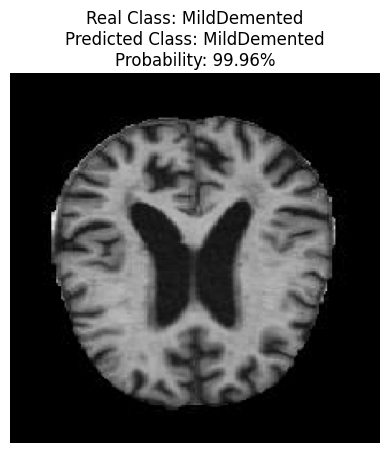

1/1 [==============================] - 0s 28ms/step


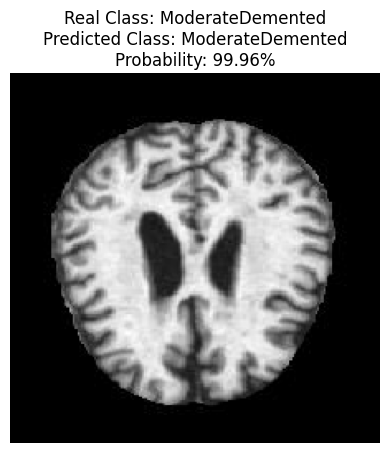

1/1 [==============================] - 0s 28ms/step


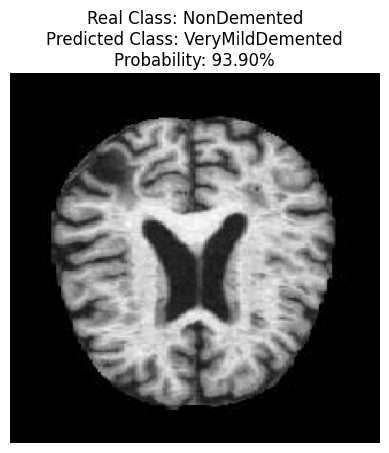

1/1 [==============================] - 0s 31ms/step


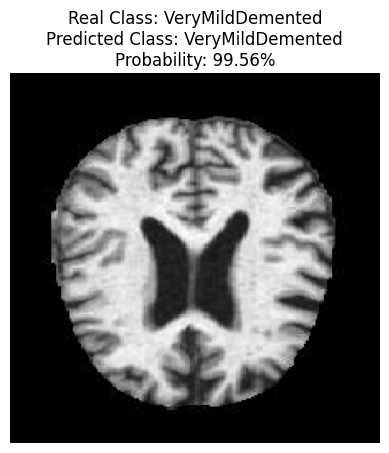

In [35]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'model' is your trained model

def predict_image(image_path):
    # Load and preprocess the image
    img = load_img(image_path, target_size=(224, 224))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0) / 255.0  # Normalize the pixel values

    # Predict the class probabilities
    predictions = model.predict(img_array)
    predicted_class = np.argmax(predictions)
    predicted_probability = np.max(predictions) * 100

    # Map class index to class label (you need to define your class labels)
    class_labels = {0: 'MildDemented', 1: 'ModerateDemented', 2: 'NonDemented', 3: 'VeryMildDemented'}
    predicted_class_label = class_labels[predicted_class]

    # Display the results
    plt.imshow(img)
    plt.title(f'Real Class: {image_path.split("/")[-2]}\nPredicted Class: {predicted_class_label}\nProbability: {predicted_probability:.2f}%')
    plt.axis('off')
    plt.show()

# Test the function with four image paths
image_paths = [
    '/content/Alzheimer_s Dataset/test/MildDemented/26 (23).jpg',
    '/content/Alzheimer_s Dataset/test/ModerateDemented/30.jpg',
    '/content/Alzheimer_s Dataset/test/NonDemented/26 (68).jpg',
    '/content/Alzheimer_s Dataset/test/VeryMildDemented/26 (48).jpg'
]

for path in image_paths:
    predict_image(path)


In [49]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np

# Example image paths (replace these with your actual image paths)
image_paths = ['/content/Alzheimer_s Dataset/test/MildDemented/26 (23).jpg',
    '/content/Alzheimer_s Dataset/test/ModerateDemented/30.jpg',
    '/content/Alzheimer_s Dataset/test/NonDemented/26 (91).jpg',
    '/content/Alzheimer_s Dataset/test/VeryMildDemented/26 (48).jpg'

]

# Function to predict and display results
def predict_and_display(image_path):
    # Load and preprocess the image
    img = load_img(image_path, target_size=(224, 224))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0

    # Make predictions
    prediction = model.predict(img_array)
    predicted_class = np.argmax(prediction)
    probability = np.max(prediction)

    # Display results
    print(f"Image: {image_path}")
    print(f"Real Class: {get_real_class(image_path)}")
    print(f"Predicted Class: {predicted_class}")
    print(f"Probability: {probability:.2%}")
    print("="*30)

# Function to get the real class from the image path
def get_real_class(image_path):
    # Extract the class name from the image path (modify as needed based on your dataset structure)
    return image_path.split('/')[-2]

# Iterate through the example image paths and make predictions
for image_path in image_paths:
    predict_and_display(image_path)


1/1 [==============================] - 0s 29ms/step
Image: /content/Alzheimer_s Dataset/test/MildDemented/26 (23).jpg
Real Class: MildDemented
Predicted Class: 0
Probability: 99.96%
1/1 [==============================] - 0s 26ms/step
Image: /content/Alzheimer_s Dataset/test/ModerateDemented/30.jpg
Real Class: ModerateDemented
Predicted Class: 1
Probability: 99.96%
1/1 [==============================] - 0s 24ms/step
Image: /content/Alzheimer_s Dataset/test/NonDemented/26 (91).jpg
Real Class: NonDemented
Predicted Class: 2
Probability: 97.41%
1/1 [==============================] - 0s 27ms/step
Image: /content/Alzheimer_s Dataset/test/VeryMildDemented/26 (48).jpg
Real Class: VeryMildDemented
Predicted Class: 3
Probability: 99.56%


In [52]:
# Assuming x_test is an instance of ImageDataGenerator
# Make sure that shuffle is set to False to maintain order
x_test.reset()

# Lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Iterate through the test set and make predictions
for _ in range(int(np.ceil(x_test.n / x_test.batch_size))):
    images, labels = next(x_test)
    predictions = model.predict(images)
    predicted_classes = np.argmax(predictions, axis=1)

    true_labels.extend(labels)
    predicted_labels.extend(predicted_classes)

# Calculate the percentage of correctly predicted images
correct_predictions = np.sum(np.array(true_labels) == np.array(predicted_labels))
total_images = len(true_labels)
accuracy_percentage = (correct_predictions / total_images) * 100

print(f"Correctly Predicted Images: {correct_predictions}/{total_images}")
print(f"Accuracy: {accuracy_percentage:.2f}%")


1/1 [==============================] - 0s 35ms/step
Correctly Predicted Images: 1190/1279
Accuracy: 93.04%


In [54]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Get model predictions on the test set
y_pred = model.predict(x_test)

# Convert predicted probabilities to class labels
y_pred_labels = np.argmax(y_pred, axis=1)

# Compute additional metrics
accuracy = accuracy_score(y_test, y_pred_labels)
precision_micro = precision_score(y_test, y_pred_labels, average='micro')
recall_micro = recall_score(y_test, y_pred_labels, average='micro')
f1_micro = f1_score(y_test, y_pred_labels, average='micro')

precision_macro = precision_score(y_test, y_pred_labels, average='macro')
recall_macro = recall_score(y_test, y_pred_labels, average='macro')
f1_macro = f1_score(y_test, y_pred_labels, average='macro')

# Print additional metrics
print(f"Accuracy: {accuracy:.2f}")
print(f"Micro Precision: {precision_micro:.2f}")
print(f"Micro Recall: {recall_micro:.2f}")
print(f"Micro F1 Score: {f1_micro:.2f}")

print(f"Macro Precision: {precision_macro:.2f}")
print(f"Macro Recall: {recall_macro:.2f}")
print(f"Macro F1 Score: {f1_macro:.2f}")


40/40 [==============================] - 3s 70ms/step
Accuracy: 0.38
Micro Precision: 0.38
Micro Recall: 0.38
Micro F1 Score: 0.38
Macro Precision: 0.24
Macro Recall: 0.24
Macro F1 Score: 0.24
